# Evolving images

Notebook with example runs and results of genetic algorithm

In [1]:
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import Image as GIF_Image
from GA import ImageEvolutionTask, GeneticAlgorithm
from utils import resize_image, save_evolution_progress_as_gif

In [2]:
INPUT_DIR = './inputs'
OUTPUT_DIR = './outputs'

In [3]:
def plot_fitness_history(
    best_fitness_history: list[float],
    current_best_fitness_history: list[float],
    mean_fitness_history: list[float]
):
    """Plot the history of fitting genetic algorithm."""
    sns.set_style('whitegrid')
    plt.figure(figsize=(7, 4))
    
    title = 'Fitness History of Genetic Algorithm'
    plt.plot(best_fitness_history, label='Best fitness', color='blue')
    plt.plot(current_best_fitness_history, label='Best fitness of current population', color='green')
    plt.plot(mean_fitness_history, label='Mean fitness of current population', color='red')
    plt.title(title, fontsize=18)
    plt.xlabel('Iteration')
    plt.ylabel('Fitness')
    plt.legend(fontsize=12)

    plt.tight_layout()
    plt.show()

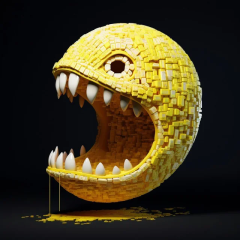

In [4]:
img_filename = 'pacman.jpg'
original_img = Image.open(os.path.join(INPUT_DIR, img_filename))
original_img_array = np.array(original_img)

original_img_array_resized = resize_image(original_img_array, height=240)
original_img_resized = Image.fromarray(original_img_array_resized)

original_img_resized

### Run without triangle maximum field restrictions

In [5]:
task_params = {
    'n_triangles': 150,
    'internal_pixels': 10000,
    'max_triangle_field': 0.5,
    'triangle_fields_penalty_strength': None
}

ga_params = {
    'population_size': 50,
    'selection_cutoff': 0.15,
    'crossover_rate': 1.,
    'mutation_rate': 0.01,
    'mutation_amount': 0.1
}

task = ImageEvolutionTask(original_img_array_resized, **task_params)
ga = GeneticAlgorithm(**ga_params)

best_img, best_img_history, current_best_img_history, current_best_fitness_history, best_fitness_history, mean_fitness_history = ga.fit(
    task=task,
    n_iter=420,
    img_history_step=1
)

Image evolution: 100%|███████████████████████████████████████████████████████████████| 420/420 [00:59<00:00,  7.11it/s]


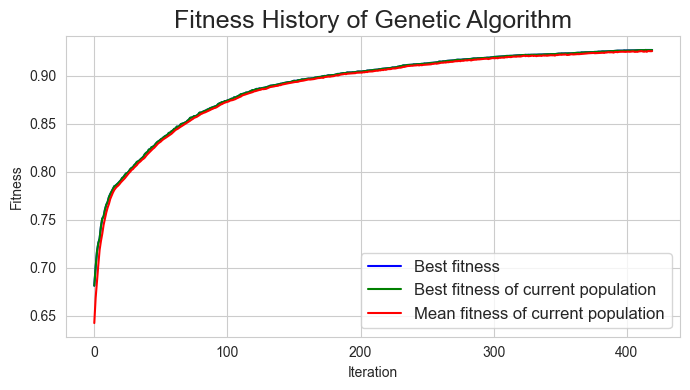

In [6]:
plot_fitness_history(best_fitness_history, current_best_fitness_history, mean_fitness_history)

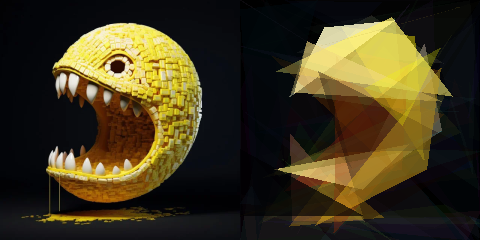

In [7]:
Image.fromarray(np.hstack((original_img_array_resized, best_img)))

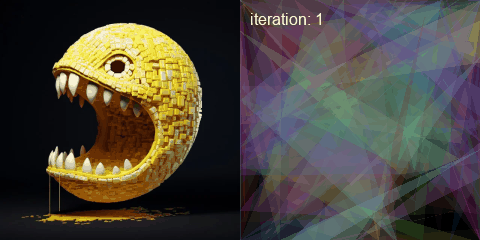

In [8]:
duration = 15
output_path = os.path.join(OUTPUT_DIR, 'pacman_evolution_progress.gif')

save_evolution_progress_as_gif(current_best_img_history, original_img_array_resized, duration, output_path)
GIF_Image(filename=output_path)

### Run with triangle maximum field restrictions

In [9]:
task_params = {
    'n_triangles': 150,
    'internal_pixels': 10000,
    'max_triangle_field': 0.02,
    'triangle_fields_penalty_strength': 5
}

ga_params = {
    'population_size': 50,
    'selection_cutoff': 0.15,
    'crossover_rate': 1.,
    'mutation_rate': 0.01,
    'mutation_amount': 0.1
}

task = ImageEvolutionTask(original_img_array_resized, **task_params)
ga = GeneticAlgorithm(**ga_params)

best_img, best_img_history, current_best_img_history, current_best_fitness_history, best_fitness_history, mean_fitness_history = ga.fit(
    task=task,
    n_iter=420,
    img_history_step=1
)

Image evolution: 100%|███████████████████████████████████████████████████████████████| 420/420 [01:02<00:00,  6.74it/s]


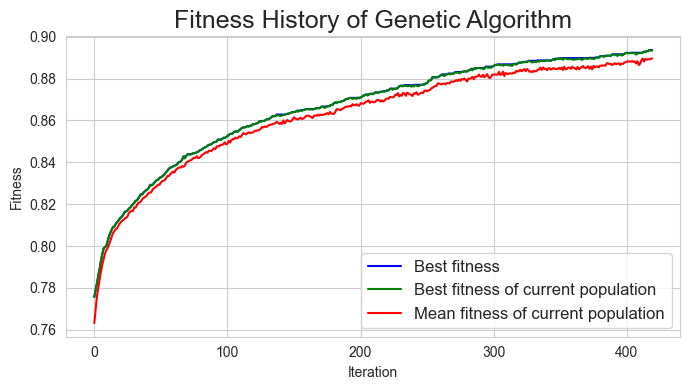

In [10]:
plot_fitness_history(best_fitness_history, current_best_fitness_history, mean_fitness_history)

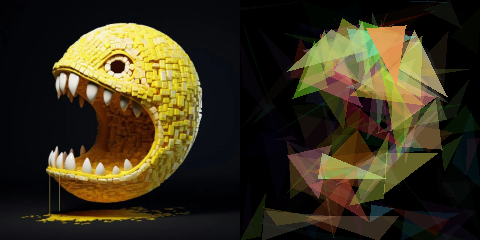

In [11]:
Image.fromarray(np.hstack((original_img_array_resized, best_img)))

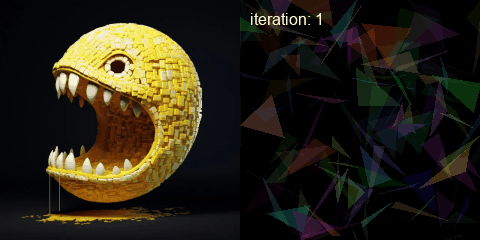

In [12]:
duration = 15
output_path = os.path.join(OUTPUT_DIR, 'pacman_evolution_progress_field_penalty.gif')

save_evolution_progress_as_gif(current_best_img_history, original_img_array_resized, duration, output_path)
GIF_Image(filename=output_path)